In [1]:
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import preprocess_input
import numpy as np
import os
import h5py
from PIL import ImageFile
import imghdr
import cv2
from google.colab.patches import cv2_imshow

In [12]:
base_path='/content/drive/My Drive/CS231.L11.KHTN/Holiday/images'
list_img=os.listdir(base_path)
list_img=list_img[:100]
list_img.sort()

['136700.jpg', '136705.jpg', '136804.jpg', '136706.jpg', '136703.jpg', '136802.jpg', '136701.jpg', '136704.jpg', '136707.jpg', '136801.jpg', '136702.jpg', '136900.jpg', '137002.jpg', '137200.jpg', '137004.jpg', '137000.jpg', '137102.jpg', '137100.jpg', '137201.jpg', '136902.jpg', '136901.jpg', '137302.jpg', '137101.jpg', '137003.jpg', '137006.jpg', '137103.jpg', '137001.jpg', '137005.jpg', '136903.jpg', '137400.jpg', '137401.jpg', '137300.jpg', '137702.jpg', '137301.jpg', '137601.jpg', '137801.jpg', '137502.jpg', '137504.jpg', '137603.jpg', '137600.jpg', '137704.jpg', '138003.jpg', '137503.jpg', '137701.jpg', '137800.jpg', '137700.jpg', '137705.jpg', '137602.jpg', '137900.jpg', '137703.jpg', '137501.jpg', '137500.jpg', '137007.jpg', '138001.jpg', '138201.jpg', '138203.jpg', '138009.jpg', '138008.jpg', '138002.jpg', '138103.jpg', '137901.jpg', '137802.jpg', '138200.jpg', '138012.jpg', '138105.jpg', '138005.jpg', '138000.jpg', '138007.jpg', '138300.jpg', '138301.jpg', '138010.jpg', '1383

In [13]:


model = VGG16(weights='imagenet', include_top=False)
global_features=[]
for i in range(100):
    img_path=os.path.join(base_path,list_img[i])
    # if imghdr.what(img_path)=='jpeg' or imghdr.what(img_path)=='JPEG':
    if '.jpg' in img_path or '.JPG' in img_path:
        print(img_path)
        ImageFile.LOAD_TRUNCATED_IMAGES = True
        img = image.load_img(img_path, target_size=(224, 224))
        x = image.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        x = preprocess_input(x)
        features = model.predict(x)
        global_features.append(features)
    # print(img_path)

/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136700.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136701.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136702.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136703.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136704.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136705.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136706.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136707.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136801.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136802.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136804.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136900.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136901.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136902.jpg
/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/136903.jpg
/content/drive/My Drive/C

In [14]:
print(np.array(global_features).shape)

(100, 1, 7, 7, 512)


In [15]:

h5_data          = '/content/drive/My Drive/18521326.h5'
h5f_data = h5py.File(h5_data, 'w')
h5f_data.create_dataset('dataset_1', data=np.array(global_features))
h5f_data.close()

In [16]:
h5_data          = '/content/drive/My Drive/18521326.h5'

In [17]:

h5f_data  = h5py.File(h5_data, 'r')
global_features_string = h5f_data['dataset_1']
global_features = np.array(global_features_string)
h5f_data.close()
print("[STATUS] features shape: {}".format(global_features.shape))

[STATUS] features shape: (100, 1, 7, 7, 512)


In [19]:
model = VGG16(weights='imagenet', include_top=False)
demo_path='/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/137102.jpg'
img = image.load_img(demo_path, target_size=(224, 224))
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x = preprocess_input(x)
features = model.predict(x)
print(features.shape)

(1, 7, 7, 512)


In [20]:

convert1d=features.flatten()
print(convert1d.shape)
distance=[]
for i in range(len(global_features)):
    con=global_features[i].flatten()
    distance.append(np.sum(np.abs(np.subtract(np.array(con),convert1d))))
for i in range(len(distance)):
    print(distance[i])


(25088,)
108005.86
143271.42
97012.14
109810.0
97524.24
81098.22
98962.1
71900.57
32298.305
32876.83
31740.986
60125.56
45433.41
65958.55
54781.445
79146.766
86627.24
68637.31
83000.56
82119.38
74782.875
70305.52
63129.203
33661.25
34400.027
0.0
25817.936
80869.36
70473.5
62989.83
63874.35
56283.137
56366.207
48456.156
93553.44
113431.016
113613.28
94668.016
96907.88
48020.258
51600.164
47470.066
52178.46
74005.74
70295.38
65281.887
67335.73
51171.54
69378.766
46945.28
49919.375
41785.24
86130.4
101589.195
83575.25
78728.14
85791.34
89539.93
93745.016
96373.22
88135.5
103935.984
99235.64
77475.51
92885.85
69676.54
84966.46
65022.793
59778.777
54301.945
52253.934
46905.836
53923.113
75763.414
79560.82
77147.26
96368.03
130641.89
116048.04
111551.88
124158.3
124685.89
94045.125
106380.7
90416.83
84521.56
86281.52
119539.07
90767.24
79473.89
81896.82
96253.375
105317.305
73445.58
72469.56
70380.5
65366.18
67284.766
64475.3
54704.05


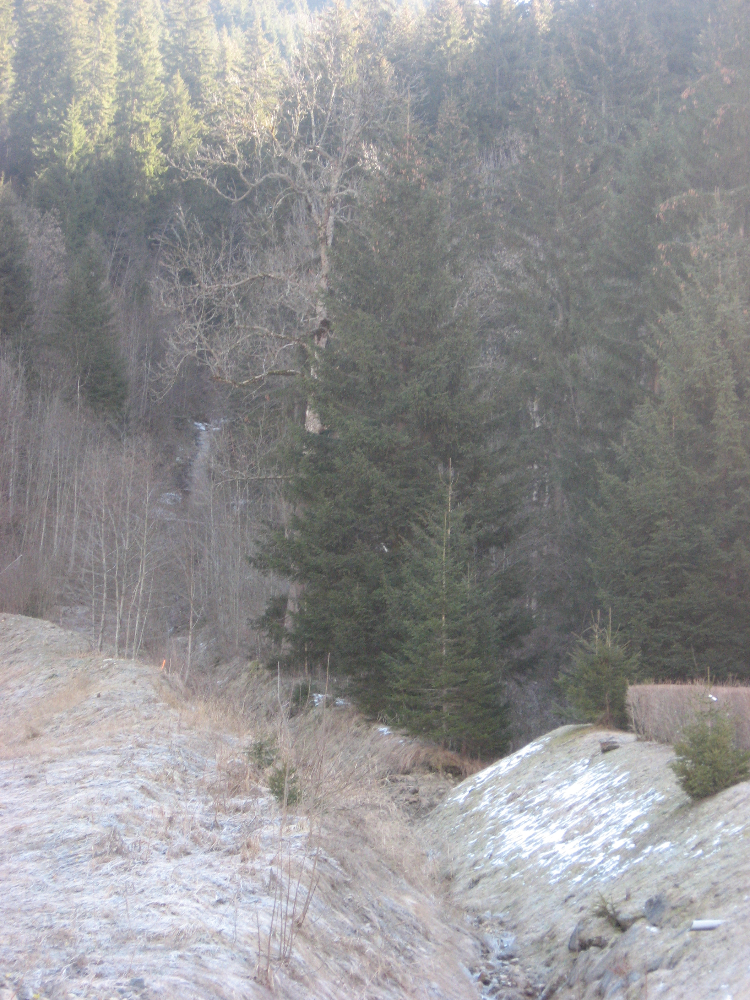

In [21]:

demo_path='/content/drive/My Drive/CS231.L11.KHTN/Holiday/images/137102.jpg'
img=cv2.imread(demo_path)
cv2_imshow(img)

In [22]:
minpos = distance.index(0.0) 
print(minpos)


25


In [23]:
from heapq import nsmallest
a=nsmallest(5, distance, key=lambda x: abs(x-0.0))
print(a)

[0.0, 25817.936, 31740.986, 32298.305, 32876.83]


In [24]:
index = distance.index(a[0])
print(index)

25


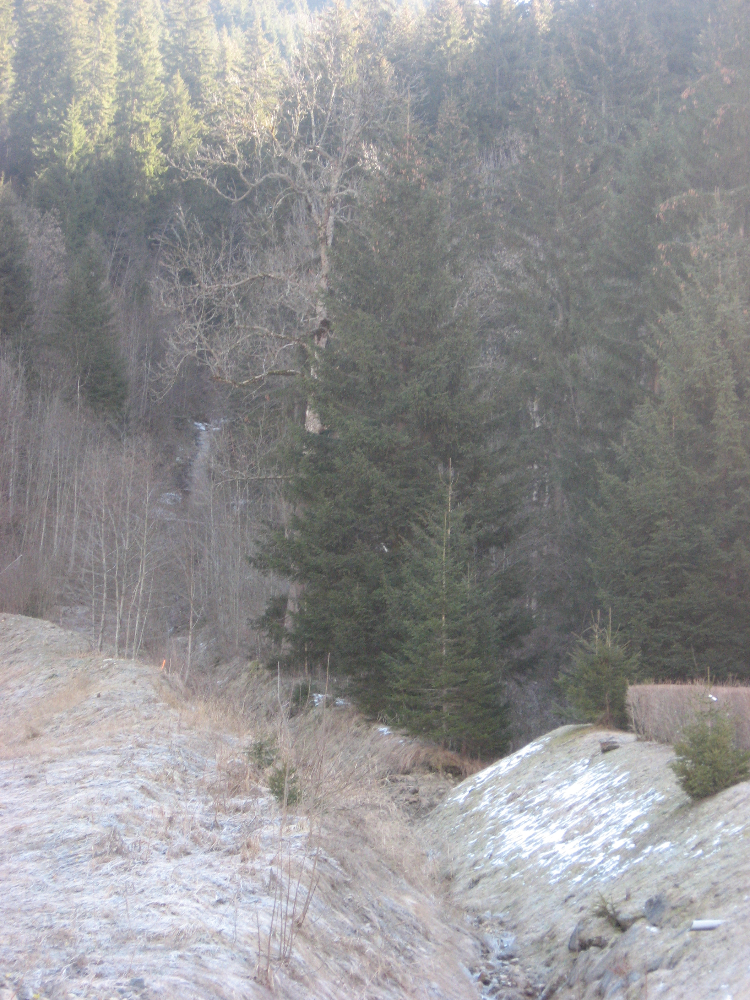

In [25]:
path=os.path.join(base_path,list_img[index])
img=cv2.imread(path)
cv2_imshow(img)